In [1]:
import tensorflow as tf
import numpy as np
from tensorflow import keras
from tensorflow.keras import layers
import pandas as pd
import matplotlib.pyplot as plt
import sys
sys.path.append("..") # Adds higher directory to python modules path.
import os
import numpy as np
import sys
import os
import pickle
import argparse
import torch
import torch.nn as nn
import torch.backends.cudnn as cudnn
import torchvision.transforms as trn
import torchvision.datasets as dset
import torch.nn.functional as F
from skimage.filters import gaussian as gblur
from PIL import Image as PILImage

sys.path.append("..") # Adds higher directory to python modules path.
import brevis
from brevis import branches
from brevis import evaluate

In [2]:
from scipy.special import logsumexp
class lambda_update(tf.keras.callbacks.Callback):
    def __init__(self, annealing_max,  lambda_t=0, max_t=1):
        self.start_val = tf.Variable(initial_value=lambda_t, dtype=tf.float32) 
        
        self.lambda_t = tf.Variable(initial_value=lambda_t, dtype=tf.float32) #updates each epoch
        self.max_t = tf.Variable(initial_value=max_t, dtype=tf.float32)
        self.annealing_max = tf.Variable(initial_value=annealing_max, dtype=tf.float32)

    def on_epoch_begin(self, epoch, logs={}): #needs to be on begin, otherwise the epoch update won't increase the value from 0 to 0.1 till the 3rd epoch...
        val = tf.reduce_min([self.max_t, tf.cast(epoch+self.start_val, tf.dtypes.float32) / tf.cast(self.annealing_max, tf.dtypes.float32)])
        tf.print("annealing coef updated to:", val)
        self.lambda_t.assign(val)
def loss_wrapper(lambda_callback: lambda_update):
    ''' Loss function of Evidential Dirichlet Networks
        Expected Mean Square Error + KL divergence
    '''
    def custom_loss_function(p, logits):
    #     alpha = alpha + 1
        evidence = exp_evidence(logits)
        alpha = evidence + 1

        S = tf.reduce_sum(alpha,axis=1,keepdims=True) 
        E = alpha - 1
        m = alpha / S
        A = tf.reduce_sum((p-m)**2, axis=1, keepdims=True) 
        B = tf.reduce_sum(alpha*(S-alpha)/(S*S*(S+1)), axis=1, keepdims=True) 
        # tf.print(annealing_coef)
        # annealing_coef = 
        annealing_coef =  lambda_callback.lambda_t
        annealing_coef =  0.0001
        alp = E*(1-p) + 1 
        C =   annealing_coef * KL(p,alpha)
        return (A + B) + C
    return custom_loss_function


# def MAEBM(lambda_callback: lambda_update):
#     import tensorflow_probability as tfp
#     def MAEBM_loss(labels, outputs):
#         n_classes=10
#         evidence = exp_evidence(outputs)
#         alpha = evidence + 1
#         soft_output= labels
#         S = tf.reduce_sum(alpha,axis=1,keepdims=True)
#         alpha_0 = S * tf.ones((outputs.shape[-1]))
#         UCE_loss = tf.reduce_mean(
#             tf.cast(soft_output,dtype=tf.float32) * (tf.compat.v1.digamma(alpha_0) - tf.compat.v1.digamma(alpha))
#         )
#         annealing_coef =  lambda_callback.lambda_t
#         dirichlet_weight = 0.1 * tf.reduce_mean(-tfp.distributions.Dirichlet(alpha).entropy())
#         UCE_loss = (
#             UCE_loss + dirichlet_weight
#         )
#         return UCE_loss
#     return MAEBM_loss


def exp_evidence(logits): 
    return tf.exp(tf.clip_by_value(logits/10,-10,10))

def KL(alpha,K):
    # print("K:",K)
    beta=tf.constant(np.ones((1,K)),dtype=tf.float32)
    S_alpha = tf.reduce_sum(alpha,axis=1,keepdims=True)
    S_beta = tf.reduce_sum(beta,axis=1,keepdims=True)
    lnB = tf.compat.v1.lgamma(S_alpha) - tf.reduce_sum(tf.compat.v1.lgamma(alpha),axis=1,keepdims=True)
    lnB_uni = tf.reduce_sum(tf.compat.v1.lgamma(beta),axis=1,keepdims=True) - tf.compat.v1.lgamma(S_beta)
    dg0 = tf.compat.v1.digamma(S_alpha)
    dg1 = tf.compat.v1.digamma(alpha)
    kl = tf.reduce_sum((alpha - beta)*(dg1-dg0),axis=1,keepdims=True) + lnB + lnB_uni
    return kl


def _KL(alphas, target_alphas,  precision=None, target_precision=None, epsilon=1e-8):
    '''
    New KL divergence function. 
    '''
    target_alphas = tf.cast(target_alphas,tf.float32)
    alphas = tf.cast(alphas,tf.float32)
    if not precision:
        precision = tf.reduce_sum(alphas, axis=1, keepdims=True)
    if not target_precision:
        target_precision = tf.reduce_sum(target_alphas, axis=1, keepdims=True)
    precision = tf.cast(precision,tf.float32)
    target_precision = tf.cast(target_precision,tf.float32)
    
    precision_term = tf.compat.v1.lgamma(target_precision) - tf.compat.v1.lgamma(precision)
    alphas_term = tf.reduce_sum(
        tf.compat.v1.lgamma(alphas + epsilon)
        - tf.compat.v1.lgamma(target_alphas + epsilon)
        + (target_alphas - alphas)
        * (
            tf.compat.v1.digamma(target_alphas + epsilon)
            - tf.compat.v1.digamma(target_precision + epsilon)
        ),
        axis=1,
        keepdims=True,
    )
    cost = tf.squeeze(precision_term + alphas_term)
    return cost

def reverse_kl(alphas, target_alphas,  precision=None, target_precision=None, epsilon=1e-8):
    return _KL(target_alphas,alphas, precision=None, target_precision=None, epsilon=1e-8)



def DirichletKLLoss(labels, logits, reverse=True):
    # alpha = tf.exp(logits)
    alpha = tf.exp(tf.clip_by_value(logits/10,-10,10))
    target_concentration = tf.reduce_sum(alpha,axis=1,keepdims=True)
    target_alphas = (tf.ones_like(alpha) + (target_concentration * labels))
    alpha = alpha + 1
    if reverse:
        cost = reverse_kl(alpha, target_alphas)
    else:
        cost = _KL(alpha, target_alphas)
    if tf.math.is_nan(tf.reduce_sum(cost)):
        tf.print("logits",logits, summarize=-1)
        tf.print("alpha",alpha, summarize=-1)
        tf.print("cost", cost, summarize=-1)
    return cost


def cross_energy(lambda_callback: lambda_update):
    #create a wrapper function that returns a function
    def cross_entropy_evidence(labels, outputs): 
        softmax = tf.nn.softmax(outputs)
        
        evidence = exp_evidence(outputs)
        alpha = evidence + 1
        S = tf.reduce_sum(alpha, axis=1, keepdims=True) 
        E = alpha - 1
        m = alpha / S
        A = tf.reduce_sum(labels * (tf.compat.v1.digamma(S) - tf.compat.v1.digamma(alpha)), axis=1, keepdims=True)
        B = tf.reduce_sum(alpha*(S-alpha)/(S*S*(S+1)), axis=1, keepdims=True) 
        alp = E*(1-labels) + 1 
        loss = tf.keras.losses.categorical_crossentropy(labels,softmax)
        annealing_rate =  lambda_callback.lambda_t
        # beta=tf.constant(np.ones((1,10)),dtype=tf.float32)
        # C =  annealing_rate * KL(alp,10)
        #A = annealing_rate * A
        
        Ec_in = -tf.math.reduce_logsumexp(outputs)
        # Ec_in = -torch.logsumexp(x[:len(in_set[0])], dim=1)
        # tf.print(0.1*(pow(tf.nn.relu(Ec_in- (-23)), 2)))
        # energy_loss = 0.1*(pow(tf.nn.relu(Ec_in- (-23)), 2)) #+ torch.pow(F.relu(args.m_out-Ec_out), 2).mean()) OLD METHOD< DID WORSE THEN ENERGY on EDL
        
        #so what about EDL + energy? 
        # val = y_hat * tf.math.log(y_hat)/tf.math.log(tf.constant(2, dtype=y_hat.dtype))
        # sumEntropies =  tf.reduce_sum(tf.boolean_mask(val,tf.math.is_finite(val)))
        energy_loss = annealing_rate * (tf.math.log(evidence)/tf.math.log(tf.constant(2, dtype=evidence.dtype)))
        
        # return loss + energy_loss #+  C
        return (A + B) + energy_loss 
    return  cross_entropy_evidence

import tensorflow_probability as tfp

def brevisEnergy(lambda_callback: lambda_update):
    ''' Proposed Loss function for BrevisNet branch classifiers
        consists of the expected mean square error loss + reverse dirichlet KL + regularizing dirichlet entropy mean
    '''
    def brevisEnergy(p, logits):
        # evidence = tf.exp(logits)
        evidence = tf.exp(tf.clip_by_value(logits/10,-10,10))
        alpha = evidence + 1
        S = tf.reduce_sum(alpha,axis=1,keepdims=True) 
        E = alpha - 1
        m = alpha / S
        A = tf.reduce_sum((p-m)**2, axis=1, keepdims=True) 
        B = tf.reduce_sum(alpha*(S-alpha)/(S*S*(S+1)), axis=1, keepdims=True) 
        annealing_coef =  lambda_callback.lambda_t
        alp = E*(1-p) + 1 
        C =   annealing_coef * DirichletKLLoss(p,logits, True)
        D = 0.0001 * -tf.reduce_mean(tfp.distributions.Dirichlet(alpha).entropy()) ###entropy of the dirichlet distribution as a smoothing regularizer. 
        return (A+B) + C + D
    return  brevisEnergy

In [3]:
import tensorflow as tf
from tensorflow.keras import Model, Input
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, Dropout
from keras_flops import get_flops
import sys
sys.path.append("..") # Adds higher directory to python modules path.
import brevis
from brevis import branches
from brevis import evaluate
tf.keras.backend.clear_session()
# build model
model = tf.keras.models.load_model("./models/journal_models/alexnet_Brev_branch_f_5.h5",custom_objects={"BranchModel":brevis.BranchModel,"brevisEnergy":brevisEnergy})
# Calculae FLOPS
# flops = get_flops(model, batch_size=1)
# print(f"FLOPS: {flops / 10 ** 9:.03} G")


preset: Other


In [6]:
_outputs=[model.get_layer("branch_exit").get_output_at(0),model.get_layer("branch_exit_1").get_output_at(0),model.get_layer("dense_2").get_output_at(0)]
temp_model = tf.keras.models.Model(inputs=model.inputs, outputs=_outputs)
# Calculae FLOPS
flops = get_flops(temp_model, batch_size=1)
print(f"FLOPS: {flops / 10 ** 9:.03} G")

FLOPS: 2.07 G


In [ ]:
outputs = model.outputs
print(outputs)
output_names = []
for i in outputs:
    output_names.append(i.name.split("/")[0])
output_names.append(output_names.pop(0))
# print(output_names)
for i, name in enumerate(output_names):
    _outputs = []
    names = output_names[:i+1]
    for j in names:
        _outputs.append(model.get_layer(j).get_output_at(0))
    temp_model = tf.keras.models.Model(inputs=model.inputs, outputs=_outputs)
    print(names)   
    # Calculae FLOPS
    flops = get_flops(temp_model, batch_size=1)
    print(f"FLOPS: {flops / 10 ** 9:.03} G")

[<KerasTensor: shape=(None, 10) dtype=float32 (created by layer 'dense_2')>, <KerasTensor: shape=(None, 10) dtype=float32 (created by layer 'branch_exit')>, <KerasTensor: shape=(None, 10) dtype=float32 (created by layer 'branch_exit_1')>]
['branch_exit']
FLOPS: 0.501 G
['branch_exit', 'branch_exit_1']


In [3]:
import tensorflow as tf

def load_pb(pb_model):
    with tf.gfile.GFile(pb_model, "rb") as f:
        graph_def = tf.GraphDef()
        graph_def.ParseFromString(f.read())
    with tf.Graph().as_default() as graph:
        tf.import_graph_def(graph_def, name='')
        return graph

def estimate_flops(pb_model):
    graph = load_pb(pb_model)
    with graph.as_default():
        # placeholder input would result in incomplete shape. So replace it with constant during model frozen.
        flops = tf.profiler.profile(graph, options=tf.profiler.ProfileOptionBuilder.float_operation())
        print('Model {} needs {} FLOPS after freezing'.format(pb_model, flops.total_float_ops))

model = ".models/cifaroutlier_blank.hdf5"
estimate_flops(model)


with tf.Session() as sess:
    with tf.Session() as sess:
        # The session is binding to the default global graph
        tf.profiler.profile(
            sess.graph,
            options=tf.profiler.ProfileOptionBuilder.float_operation())
        parameters = tf.profiler.profile(sess.graph,
                                         options=tf.profiler.ProfileOptionBuilder
                                         .trainable_variables_parameter())
        print ('total parameters: {}'.format(parameters.total_parameters))
    

AttributeError: module 'tensorflow' has no attribute 'gfile'

In [2]:
K= 10
# This function to generate evidence is used for the first example
def relu_evidence(logits):
    return tf.nn.relu(logits)

# This one usually works better and used for the second and third examples
# For general settings and different datasets, you may try this one first
def exp_evidence(logits): 
    return tf.exp(tf.clip_by_value(logits,-10,10))

# This one is another alternative and 
# usually behaves better than the relu_evidence 
def softplus_evidence(logits):
    return tf.nn.softplus(logits)

def KL(alpha):
    # print("K:",K)
    beta=tf.constant(np.ones((1,K)),dtype=tf.float32)
    S_alpha = tf.reduce_sum(alpha,axis=1,keepdims=True)
    S_beta = tf.reduce_sum(beta,axis=1,keepdims=True)
    lnB = tf.compat.v1.lgamma(S_alpha) - tf.reduce_sum(tf.compat.v1.lgamma(alpha),axis=1,keepdims=True)
    lnB_uni = tf.reduce_sum(tf.compat.v1.lgamma(beta),axis=1,keepdims=True) - tf.compat.v1.lgamma(S_beta)

    dg0 = tf.compat.v1.digamma(S_alpha)
    dg1 = tf.compat.v1.digamma(alpha)

    kl = tf.reduce_sum((alpha - beta)*(dg1-dg0),axis=1,keepdims=True) + lnB + lnB_uni
    # print("kl", kl)
    return kl

In [3]:
K = 10
def loss_function(annealing_rate=1, momentum=1, decay=1, global_loss=False):
    #create a wrapper function that returns a function
    temperature = 1
    Classes = 10
    keras_kl = tf.keras.losses.KLDivergence()
    annealing_rate = annealing_rate
    momentum_rate = momentum
    decay_rate = decay
    def cross_entropy_evidence(labels, outputs): 
        softmax = tf.nn.softmax(outputs)
        # activated_outputs =tf.keras.activations.sigmoid(softmax)
        evidence = softplus_evidence(outputs)
        alpha = evidence + 1
        S = tf.reduce_sum(alpha, axis=1, keepdims=True) 
        E = alpha - 1
        m = alpha / S
        A = tf.reduce_sum((labels-m)**2, axis=1, keepdims=True) 
        B = tf.reduce_sum(alpha*(S-alpha)/(S*S*(S+1)), axis=1, keepdims=True) 

        annealing_coef = tf.minimum(1.0,tf.cast(annealing_rate,tf.float32))
#         annealing_coef = 1
        alp = E*(1-labels) + 1 
        # print("alp", alp)
        C =  annealing_coef * KL(alp)
        # C = keras_kl(labels,evidence)
        loss = tf.keras.losses.categorical_crossentropy(labels, softmax)
        pred = tf.argmax(outputs,1)
        truth = tf.argmax(labels,1)
        match = tf.reshape(tf.cast(tf.equal(pred, truth), tf.float32),(-1,1))
        return loss + C
        # return (A + B) + C
    return  cross_entropy_evidence

In [4]:
dataset = branching.dataset.prepare.dataset(tf.keras.datasets.cifar10.load_data(),32,5000,22500,(224,224),include_targets=True)


augment Dataset
targetsis : True
adding targets to inputs
trainSize 45000
testSize 10000


In [5]:
# import os
# from tensorflow.python.tools import freeze_graph
# import re
# import json
# import tensorflow.keras.backend as K
# log_path = './profiles/cpm_352_profile/'
# if not os.path.exists(log_path):
#     os.makedirs(log_path)

# from tensorflow.python.framework.convert_to_constants import  convert_variables_to_constants_v2_as_graph
# run_meta = tf.compat.v1.RunMetadata()
# #     A = tf.Variable(tf.random_normal([25,16]))
# #     B = tf.Variable(tf.random_normal([16,9]))
# #     C = tf.matmul(A,B)
# inputs = keras.Input(shape=(227,227,3),name="Input")
# x = keras.layers.Conv2D(filters=96, kernel_size=(11,11), strides=(4,4), activation='relu', input_shape=(227,227,3),name="layer_1")(inputs)
# x = keras.layers.BatchNormalization()(x)
# x = keras.layers.MaxPool2D(pool_size=(3,3), strides=(2,2))(x)
# x = keras.layers.Conv2D(filters=256, kernel_size=(5,5), strides=(1,1), activation='relu', padding="same")(x)
# x = keras.layers.BatchNormalization()(x)
# x = keras.layers.MaxPool2D(pool_size=(3,3), strides=(2,2))(x)
# x = keras.layers.Conv2D(filters=384, kernel_size=(3,3), strides=(1,1), activation='relu', padding="same")(x)
# x = keras.layers.BatchNormalization()(x)
# x = keras.layers.Conv2D(filters=384, kernel_size=(1,1), strides=(1,1), activation='relu', padding="same")(x)
# x = keras.layers.BatchNormalization()(x)
# x = keras.layers.Conv2D(filters=256, kernel_size=(1,1), strides=(1,1), activation='relu', padding="same")(x)
# x = keras.layers.BatchNormalization()(x)
# x = keras.layers.MaxPool2D(pool_size=(3,3), strides=(2,2))(x)
# x = keras.layers.Flatten(name="flatten")(x)
# x = keras.layers.Dense(4096, activation='relu')(x)
# x = keras.layers.Dropout(0.5)(x)
# x = keras.layers.Dense(4096, activation='relu')(x)
# x = keras.layers.Dropout(0.5)(x)
# x = keras.layers.Dense(10, activation='softmax')(x)
# model = keras.Model(inputs=inputs, outputs=[x], name="alexnet")
    

        

In [6]:
custom_objects = {"CrossEntropyEndpoint":branching.branches.branch.CrossEntropyEndpoint,"cross_entropy_evidence":loss_function()}
model = tf.keras.models.load_model("models/alexNetv6_entropy_conv2d_test.hdf5",custom_objects=custom_objects)
model.summary()

inputShape TensorShape([None, 4096])
Model: "model_branched"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 227, 227, 3) 0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 55, 55, 96)   34944       input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 55, 55, 96)   384         conv2d_1[0][0]                   
__________________________________________________________________________________________________
max_pooling2d (MaxPooling2D)    (None, 27, 27, 96)   0           batch_normalization[0][0]        
________________________________________________

In [17]:
def get_flops_branches(input_model,endpoints=None, custom_objects=None):
    if endpoints==None:
        endpoints=[]
        for end in input_model.outputs:
            endpoints.append(end.name.partition("/")[0])
    layer_names=[]
    for layer in input_model.layers:
        layer_names.append(layer.name)
    print("layer names: ", layer_names)
    input_model.save("temp.hdf5")
    
    with tf.Graph().as_default() as graph:
        model = tf.keras.models.load_model("temp.hdf5",custom_objects)
        print("inputs",model.inputs)
        print("outputs",model.outputs)
        with graph.as_default():
            opt = tf.compat.v1.profiler.ProfileOptionBuilder.float_operation()
            flops = tf.compat.v1.profiler.profile(graph, options=opt)
            total_flops = flops.total_float_ops
            print ('wholeModel: Total Flops : {}'.format(total_flops))
    
    for endpoint in endpoints:
        if type(endpoint) == list:
#         input_model= tf.keras.models.load_model("../models/alexNetv6_logits.hdf5")
#         temp_model = tf.keras.models.clone_model(input_model.inputs, input_model.get_layer(endpoint).get_output_at(0))
            outputs=[]
            for end in endpoint:
                print(end)
                outputs.append(input_model.get_layer(end).get_output_at(0))
            temp_model = tf.keras.models.Model(input_model.inputs, outputs)
        else: 
            temp_model = tf.keras.models.Model(input_model.inputs, input_model.get_layer(endpoint).get_output_at(0))
        temp_model.save("temp.hdf5")
        with tf.Graph().as_default() as graph:
            model = tf.keras.models.load_model("temp.hdf5",custom_objects)
#             model = tf.keras.models.clone_model(input_model.inputs, input_model.get_layer(endpoint).get_output_at(0))
            with graph.as_default():
                opt = tf.compat.v1.profiler.ProfileOptionBuilder.float_operation()
                flops = tf.compat.v1.profiler.profile(graph, options=opt)
                total_flops = flops.total_float_ops
                print ('{}: Total Flops : {}'.format(endpoint, total_flops))
    return    
custom_objects = {"CrossEntropyEndpoint":branching.branches.branch.CrossEntropyEndpoint,"cross_entropy_evidence":loss_function()}
# input_model= tf.keras.models.load_model("models/resNet_evidence_conv2d.hdf5",custom_objects=custom_objects)
input_model= tf.keras.models.load_model("models/mobileNetv2_finetuned.hdf5",custom_objects=custom_objects)
# input_model= tf.keras.models.load_model("models/alexNetv6_logits.hdf5",custom_objects=custom_objects)
input_model.compile(loss=loss_function(), optimizer=tf.optimizers.SGD(lr=0.001, momentum=0.9), metrics=['accuracy'],run_eagerly=True)

# resnet
# get_flops_branches(input_model,endpoints=[["branch_softmax_1"],["classification"],["branch_softmax_1","classification"],],custom_objects = custom_objects)
input_model.summary()
# get_flops_branches(input_model,endpoints=[["branch_softmax"],["branch_softmax","branch_softmax_1"],["branch_softmax","branch_softmax_1","branch_softmax_2"],["branch_softmax","branch_softmax_1","branch_softmax_2","classification"],["classification"]],custom_objects = custom_objects)
# get_flops_branches(input_model,endpoints=[["branch_softmax_3"],["branch_softmax_3","branch_softmax_4"],["branch_softmax_3","branch_softmax_4","branch_softmax_5"],["branch_softmax_3","branch_softmax_4","branch_softmax_5","classification"],["classification"]],custom_objects = custom_objects)
get_flops_branches(input_model,endpoints=[["classification"]],custom_objects = custom_objects)

#mobilenet
# get_flops_branches(input_model,endpoints=[["branch_softmax"],["branch_softmax","branch_softmax_1"],["branch_softmax","branch_softmax_1","branch_softmax_2"],["branch_softmax","branch_softmax_1","branch_softmax_2","classification"],["classification"]],custom_objects = custom_objects)

# alexnet
# get_flops_branches(input_model,endpoints=[["branch_softmax_6"],["branch_softmax_6","branch_softmax_7"],["branch_softmax_6","branch_softmax_7","branch_softmax_8"],["branch_softmax_6","branch_softmax_7","branch_softmax_8","dense_2"],["dense_2"]],custom_objects = custom_objects)

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 224, 224, 3) 0                                            
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 112, 112, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 112, 112, 32) 128         Conv1[0][0]                      
__________________________________________________________________________________________________
Conv1_relu (ReLU)               (None, 112, 112, 32) 0           bn_Conv1[0][0]                   
______________________________________________________________________________________________

88 ops no flops stats due to incomplete shapes.


wholeModel: Total Flops : 4473525
classification


56 ops no flops stats due to incomplete shapes.


['classification']: Total Flops : 4473501


In [5]:
import keras.backend as K_sess
# from keras.applications.resnet50 import ResNet50


def freeze_session(session, keep_var_names=None, output_names=None, clear_devices=True):
    graph = session.graph
    with graph.as_default():
        freeze_var_names = list(set(v.op.name for v in tf.compat.v1.global_variables()).difference(keep_var_names or []))
        output_names = output_names or []
        output_names += [v.op.name for v in tf.compat.v1.global_variables()]
        input_graph_def = graph.as_graph_def()
        if clear_devices:
            for node in input_graph_def.node:
                node.device = ""
        frozen_graph = tf.compat.v1.graph_util.convert_variables_to_constants(
            session, input_graph_def, output_names, freeze_var_names)
        return frozen_graph


def load_pb(pb):
    with tf.compat.v1.gfile.GFile(pb, "rb") as f:
        graph_def = tf.compat.v1.GraphDef()
        graph_def.ParseFromString(f.read())
    with tf.Graph().as_default() as graph:
        tf.import_graph_def(graph_def, name='')
        return graph


run_meta = tf.compat.v1.RunMetadata()
with tf.compat.v1.Session(graph=tf.Graph()) as sess:
    K_sess.set_session(sess)
#     net = ResNet50(include_top=True, weights="imagenet", input_tensor=tf.keras.Input(name="input", shape=(1, 32, 32, 3), dtype=tf.dtypes.float32), input_shape=None, pooling=None, classes=1000)
    net = tf.keras.models.load_model("../models/alexNetv6_logits.hdf5")
    frozen_graph = freeze_session(sess, output_names=[out.op.name for out in net.outputs])
    with tf.compat.v1.gfile.GFile('graph.pb', "wb") as f:
        f.write(frozen_graph.SerializeToString())

    g2 = load_pb('./graph.pb')
    with g2.as_default():
        flops = tf.compat.v1.profiler.profile(g2, options=tf.compat.v1.profiler.ProfileOptionBuilder.float_operation())
        print('FLOP after freezing {} MFLOPS'.format(float(flops.total_float_ops//2) * 1e-6))

Instructions for updating:
Colocations handled automatically by placer.
Instructions for updating:
Use `tf.compat.v1.graph_util.convert_variables_to_constants`
Instructions for updating:
Use `tf.compat.v1.graph_util.extract_sub_graph`
Instructions for updating:
Use `tf.compat.v1.graph_util.tensor_shape_from_node_def_name`


20 ops no flops stats due to incomplete shapes.


FLOP after freezing 0.0 MFLOPS


In [19]:

# https://medium.com/swlh/freezing-and-calculating-flops-in-tensorflow-6a6414482018

from tensorflow.python.framework.convert_to_constants import convert_variables_to_constants_v2
def get_flops(model):

        '''
            Notes about profiler: 
                Models loaded within a graph focus stack, so if you load two models into the same graph, the flops are combined
                Stuff done beforehand are not counted
                the show_name_regexes for all layers of a model is very close, but not exactly the same as the total flops count of a model
                    Not sure why this is, but its close enough to use for now I think
                    As long as its consistent across the different models I use it on.
                in show names, if you want to specify a specific layer in the regex, put a '/' after the keras layer name.
                    this captures all the underlying layers of that specific layer. for example, "dense_1/.*" captures 
                        dense_1/kernel/Initializer/random_uniform (262.14k/524.29k flops)
                            dense_1/kernel/Initializer/random_uniform/mul (262.14k/262.14k flops)
                            dense_1/kernel/Initializer/random_uniform/sub (1/1 flops)
                    this is useful when you have layers that will have repeating iteration names such as dense, dense_1 etc.
        '''
        input_model= tf.keras.models.load_model("../models/alexNetv6_logits.hdf5")
        temp_model = tf.keras.models.Model(input_model.inputs, input_model.outputs)
        temp_model.save("temp.hdf5")
        with tf.Graph().as_default() as graph:
            model = tf.keras.models.load_model("temp.hdf5")
#             tf.import_graph_def(graph_def, name='')
#             with graph.as_default():
# #                 model= tf.keras.models.load_model("../models/alexNetv6_logits.hdf5")
#                 opt = tf.compat.v1.profiler.ProfileOptionBuilder.float_operation()
#                 flops = tf.compat.v1.profiler.profile(graph, options=opt)
#                 total_flops = flops.total_float_ops
#                 print ('Total Flops : {}'.format(total_flops))
                
#             with graph.as_default():
#                 model= tf.keras.models.load_model("../models/alexNetv6_logits.hdf5")
#                 opt = tf.compat.v1.profiler.ProfileOptionBuilder.float_operation()
#                 flops = tf.compat.v1.profiler.profile(graph, options=opt)
#                 total_flops = flops.total_float_ops
#                 print ('Total Flops : {}'.format(total_flops))
            
            model.compile(optimizer="adam",
                  loss="sparse_categorical_crossentropy",
                  metrics=["accuracy"])
            sum_flops=0
            with graph.as_default():
#                 model = tf.keras.models.Model(model2.inputs, model2.outputs)
#                 model.compile(optimizer="adam",
#                   loss="sparse_categorical_crossentropy",
#                   metrics=["accuracy"])
#                 model= tf.keras.models.load_model("../models/mnistNormal_branched.hdf5")
                layer_names=[]
                for layer in model.layers:
                    layer_names.append('.*'+layer.name+'/.*')
                print(layer_names)
                model.summary()
                opt = tf.compat.v1.profiler.ProfileOptionBuilder.float_operation()
                flops = tf.compat.v1.profiler.profile(graph, options=opt)
                total_flops = flops.total_float_ops
                print ('Total Flops : {}'.format(total_flops))
#                 layer_names_2 = ['.*input_2.*', '.*conv2d_1.*', '.*batch_normalization.*',
#                                  '.*max_pooling2d.*', '.*conv2d_2.*', 'batch_normalization_1.*',
#                                  'max_pooling2d_1', 'conv2d_3', 'batch_normalization_2',
#                                  'conv2d_4', 'batch_normalization_3', 'conv2d_5',
#                                  'batch_normalization_4', 'max_pooling2d_2', 'flatten',
#                                  'dense', 'dropout', 'dense_1', 'dropout_1', 'dense_2']
#                 show_layers=[]
                for layer in layer_names:
#                     show_layers.append(layer)
                    opt = (tf.compat.v1.profiler.ProfileOptionBuilder(
                           tf.compat.v1.profiler.ProfileOptionBuilder.float_operation())
                           .with_node_names(show_name_regexes=layer_names, trim_name_regexes=[layer])
#                                trim_name_regexes=['.*branch_softmax']
    #                        .with_node_names(start_name_regexes=['.*input_2.*',
    # # #                                                            '.*batch_normalization.*',
    #                                                            ],
    #                                         show_name_regexes=layer_names)
                           .order_by('flops')
                           .with_file_output(''+'enc_log.txt')
                           .build())
                    flops = tf.compat.v1.profiler.profile(graph, options=opt)
                    print(layer, flops.total_float_ops)
                    sum_flops = sum_flops + flops.total_float_ops
                print("sum flops", sum_flops)
                enc_flops = flops.total_float_ops
                
#                 opt = (tf.compat.v1.profiler.ProfileOptionBuilder(
#                        tf.compat.v1.profiler.ProfileOptionBuilder.float_operation())
#                        .order_by('flops')
#                        .with_file_output(log_path+'enc_log.txt')
#                        .build())
#                 print(g)
#                 flops = tf.compat.v1.profiler.profile(g, options=opt)
#                 enc_flops = flops.total_float_ops
#                 stage_names=[['.*input_2.*','.*batch_normalization.*']]
#                 stage_flops = []
#                 for stage_num in range(0,6):
#                     opt = (tf.compat.v1.profiler.ProfileOptionBuilder(
#                            tf.compat.v1.profiler.ProfileOptionBuilder.float_operation())
#                            .with_node_names("stage_1")
# #                            .with_file_output(log_path+'stage_{}_log.txt'.format(stage_num))
#                            .build())

#                     flops = tf.compat.v1.profiler.profile(g, options=opt)
#                     #print ('Stage : {}'.format(stage_num))
#                     #print('FLOPS', flops.total_float_ops)

#                     stage_flops.append(flops.total_float_ops)


                print ("========================================================")
                print ('Total Flops : {}'.format(total_flops))
                print ('Enc. Flops : {}'.format(enc_flops))
#                 for stage_num, flops in enumerate(stage_flops):
#                     print ('Stage {} Flops {}'.format(stage_num+1, flops))
                    
#         run_meta = tf.compat.v1.RunMetadata()
#         opts = tf.compat.v1.profiler.ProfileOptionBuilder.float_operation()
#         # opts.order_by("depth") ## so this order_by option has been removed from TF, but remains in the docs. so we have to make it ourselves.
#         opts["output"]="file:outfile=models/_flops_2.txt"
#         flops = tf.compat.v1.profiler.profile(graph=graph, run_meta=run_meta, cmd="scope", options=opts)
#         print(flops)
#         # for i, layer in enumerate(flops):
#         #     print(layer)
#         print("outputfile: ")

#         # f = open("models/_flops.txt", "r")
#         # #skip to the data we want
#         # for i in range(0,8):
#         #     f.readline()
#         # #process through each line of the profiler output
#         # for x in f:
#         #     # print(x)    
#         #     #NOTE, these regex should work fine as long as you haven't used backslashes / or parenthesis in your model and layer names.
#         #     name = (re.search("(\/[0-z]*\/)", x).group().replace("/","")) #find the layer name
#         #     layerflops = (re.search("(\([0-z.]*\/)", x).group().replace("/","").replace("(","")) #find the flop count
#         #     modelLayers[name]["flops"] = layerflops
#         # f.close()
#         print(modelLayers)
        return flops.total_float_ops
get_flops("model")

['.*input_2/.*', '.*conv2d_1/.*', '.*batch_normalization/.*', '.*max_pooling2d/.*', '.*conv2d_2/.*', '.*batch_normalization_1/.*', '.*max_pooling2d_1/.*', '.*conv2d_3/.*', '.*batch_normalization_2/.*', '.*conv2d_4/.*', '.*batch_normalization_3/.*', '.*conv2d_5/.*', '.*batch_normalization_4/.*', '.*max_pooling2d_2/.*', '.*flatten/.*', '.*dense/.*', '.*dropout/.*', '.*dense_1/.*', '.*dropout_1/.*', '.*dense_2/.*']
Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 227, 227, 3)]     0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 55, 55, 96)        34944     
_________________________________________________________________
batch_normalization (BatchNo (None, 55, 55, 96)        384       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 27,

25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.


.*input_2/.* 112698834
.*conv2d_1/.* 112629137
.*batch_normalization/.* 112698448
.*max_pooling2d/.* 112698834


25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.


.*conv2d_2/.* 111470033
.*batch_normalization_1/.* 112697808
.*max_pooling2d_1/.* 112698834


25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.


.*conv2d_3/.* 110929361
.*batch_normalization_2/.* 112697296
.*conv2d_4/.* 112403921


25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.


.*batch_normalization_3/.* 112697296
.*conv2d_5/.* 112502225
.*batch_normalization_4/.* 112697808


25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.


.*max_pooling2d_2/.* 112698834
.*flatten/.* 112698834
.*dense/.* 37201361


25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.


.*dropout/.* 112698834
.*dense_1/.* 79144401
.*dropout_1/.* 112698834
.*dense_2/.* 112616913
sum flops 2141277846
Total Flops : 112698835
Enc. Flops : 112616913


25 ops no flops stats due to incomplete shapes.
25 ops no flops stats due to incomplete shapes.


112616913

In [88]:
(train_images, train_labels), (test_images, test_labels) = tf.keras.datasets.cifar10.load_data()
K= 10 # number of classes
test_labels = tf.keras.utils.to_categorical(test_labels,10)
shuffle_size = 22500
batch_size=1
test_ds = tf.data.Dataset.from_tensor_slices((test_images, test_labels))
def augment_images(image, label,input_size=(227,227), channel_first = False):
            image = tf.image.resize(image,input_size)
            if channel_first:
                image = tf.transpose(image, [2, 0, 1])
            return image, label
test_ds_size = len(list(test_ds))
test_ds = (test_ds.map(augment_images))
t_target = tf.data.Dataset.from_tensor_slices((test_labels))
test_ds = tf.data.Dataset.zip((test_ds,t_target))
test_ds = (test_ds.batch(batch_size=1, drop_remainder=True))

In [ ]:

print(tf.executing_eagerly())
def get_flops(model):
    with g.as_default():
        model = tf.saved_model.load(mobilenet_save_path)
        print(list(model.signatures.keys()))  # ["serving_default"]

        # model.summary()
        #first up, get layer names and order.
        modelLayers ={}
#         for i, layer in enumerate(model.layers):
#             modelLayers[layer.name] = {"depth":i,"flops":0, "cumulativeFlops":0}
        # print(modelLayers)
        concrete = tf.function(lambda inputs: model(inputs))
        print(concrete)
        concrete_func = concrete.get_concrete_function(
            [tf.TensorSpec([1, *inputs.shape[1:]]) for inputs in model.inputs])
        frozen_func, graph_def = convert_variables_to_constants_v2_as_graph(concrete_func)
        print(tf.compat.v1.profiler.ProfileOptionBuilder.float_operation())
        with tf.Graph().as_default() as graph:
            tf.graph_util.import_graph_def(graph_def, name='')
            run_meta = tf.compat.v1.RunMetadata()
    #         opts = tf.compat.v1.profiler.ProfileOptionBuilder.float_operation()
    #         # opts.order_by("depth") ## so this order_by option has been removed from TF, but remains in the docs. so we have to make it ourselves.
    #         opts["output"]="file:outfile=models/_flops_2.txt"
    #         flops = tf.compat.v1.profiler.profile(graph=graph, run_meta=run_meta, cmd="scope", options=opts)
    #         print(flops)
    #         # for i, layer in enumerate(flops):
    #         #     print(layer)
    #         print("outputfile: ")

    #         print(modelLayers)
    #         return flops.total_float_ops
print(get_flops(model))

In [101]:

# Predictions = collectEvidence_branches(model,test_ds)
Outputs = collectEvidence_branches(model,test_ds, False)
# print(Outputs)

In [105]:
### alexNetv6_entropy_branched_scratch_40
print(displayEvidence(Outputs, Evidence = False))
displayEvidence_cascade(Outputs, Evidence = False)

mean 1.718735126131382  std 0.7074414784859665
mean 1.645926748956525  std 0.6461887777680513


0.0023523349233010383 0.01971064615708323
rollover enabled, 8843 predictions provided


C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:244: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:244: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


0.002262563600773609 0.010955125209130423
rollover enabled, 7414 predictions provided
0.004164245506177516 0.014165417394751958
rollover enabled, 3099 predictions provided
0 0.0


C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:244: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:279: RuntimeWarning: invalid value encountered in longlong_scalars
C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:280: RuntimeWarning: invalid value encountered in longlong_scalars


<Figure size 432x288 with 0 Axes>

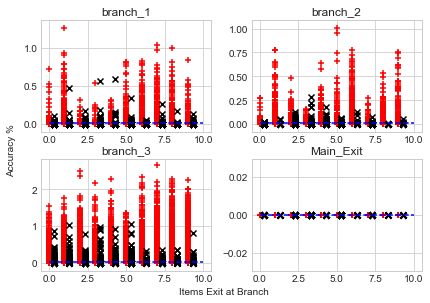

,Branch Name,Predictions,Accuracy,E_Threshold,acceptance_rate,accepted_correct,accepted_incorrect,accepted_accuracy,overlap_adjusted_accuracy,rejected_correct,rejected_incorrect,Incorrects_overlap
0,branch_1,10000,0.635700,0.022063,0.115700,1080,77,0.933449,0.960242,5277,3566,31
1,branch_2,8843,0.723284,0.013218,0.161597,1328,101,0.929321,0.966410,5068,2346,53
2,branch_3,7414,0.780550,0.018330,0.582007,3984,331,0.923291,0.997914,1803,1296,322
3,Main_Exit,3099,0.589868,0.000000,0.000000,0,0,NaN,NaN,0,0,0


In [87]:
### alexNetv6_evidence_conv2d #30
displayEvidence_cascade(Outputs, Evidence = True)

C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:97: RuntimeWarning: invalid value encountered in longlong_scalars


<Figure size 432x288 with 0 Axes>

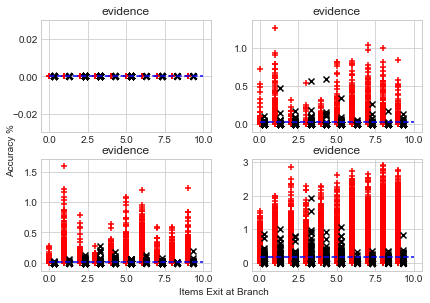

,Branch Name,Accuracy,E_Threshold,acceptance_rate,accepted_correct,accepted_incorrect,accepted_accuracy,overlap_adjusted_accuracy,rejected_correct,rejected_incorrect,Incorrects_overlap
0,main_exit,0.8276,0.000000,0.0000,0,0,NaN,NaN,0,0,0
1,branch_1,0.6357,0.022778,0.1146,1072,74,0.935428,0.960733,5285,3569,29
2,branch_2,0.7485,0.016213,0.1935,1835,100,0.948320,0.975194,5650,2415,52
3,branch_3,0.8245,0.170509,0.5132,5002,130,0.974669,0.999805,3243,1625,129


In [17]:
### alexNetv6_evidence_conv2d #30
displayEvidence(Outputs, Evidence = True)

C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:97: RuntimeWarning: invalid value encountered in longlong_scalars


<Figure size 432x288 with 0 Axes>

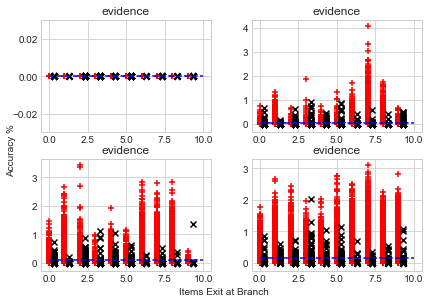

,Branch Name,Accuracy,E_Threshold,acceptance_rate,accepted_correct,accepted_incorrect,accepted_accuracy,overlap_adjusted_accuracy,rejected_correct,rejected_incorrect,Incorrects_overlap
0,main_exit,0.8241,0.000000,0.0000,0,0,NaN,NaN,0,0,0
1,branch_1,0.6008,0.058877,0.1254,1152,102,0.918660,0.952951,4856,3890,43
2,branch_2,0.7426,0.087509,0.2614,2520,94,0.964040,0.988141,4906,2480,63
3,branch_3,0.8199,0.163141,0.5012,4898,114,0.977255,1.000000,3301,1687,114


In [ ]:
### Continued Evidence flatBranch no transfer #30
displayEvidence(Outputs, Evidence = True)

C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:97: RuntimeWarning: invalid value encountered in longlong_scalars


<Figure size 432x288 with 0 Axes>

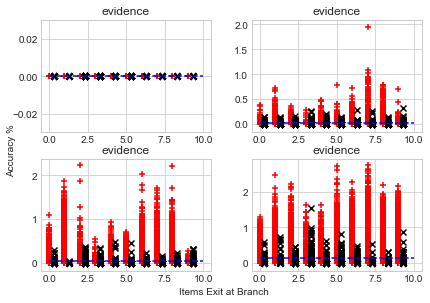

,Branch Name,Accuracy,E_Threshold,acceptance_rate,accepted_correct,accepted_incorrect,accepted_accuracy,overlap_adjusted_accuracy,rejected_correct,rejected_incorrect,Incorrects_overlap
0,main_exit,0.8276,0.000000,0.0000,0,0,NaN,NaN,0,0,0
1,branch_1,0.5956,0.022803,0.1486,1295,191,0.871467,0.921265,4661,3853,74
2,branch_2,0.7315,0.041697,0.2760,2639,121,0.956159,0.982971,4676,2564,74
3,branch_3,0.8189,0.138771,0.4914,4780,134,0.972731,0.999593,3409,1677,132


In [ ]:
### Continued Evidence flatBranch no transfer
displayEvidence(Outputs, Evidence = True)

C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:96: RuntimeWarning: invalid value encountered in longlong_scalars
C:\Users\Sanity\AppData\Local\conda\conda\envs\py36\lib\site-packages\ipykernel_launcher.py:97: RuntimeWarning: invalid value encountered in longlong_scalars


<Figure size 432x288 with 0 Axes>

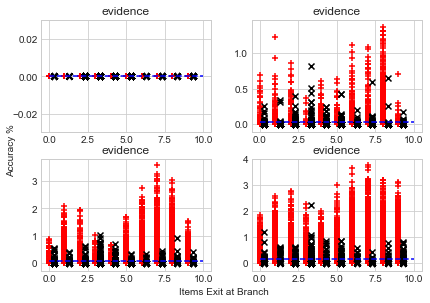

,Branch Name,Accuracy,E_Threshold,acceptance_rate,accepted_correct,accepted_incorrect,accepted_accuracy,overlap_adjusted_accuracy,rejected_correct,rejected_incorrect,Incorrects_overlap
0,main_exit,0.7939,0.000000,0.0000,0,0,NaN,NaN,0,0,0
1,branch_1,0.6057,0.035665,0.0951,866,85,0.910620,0.961094,5191,3858,48
2,branch_2,0.7084,0.080074,0.2398,2283,115,0.952043,0.983736,4801,2801,76
3,branch_3,0.8067,0.158862,0.4431,4311,120,0.972918,0.998646,3756,1813,114


In [ ]:
### Continued Evidence flatBranch 
displayEvidence(Outputs, Evidence = True)